In [ ]:
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from tf_explain.core.grad_cam import GradCAM
import tensorflow as tf
from tensorflow import keras
from keras import backend as K
import warnings

warnings.filterwarnings("ignore")

In [ ]:
labels = {
    0: "Common Nevus",
    1: "Atypical Nevus",
    2: "Melanoma"
}

images = []
image_segmentations = []
image_labels = []

In [ ]:
df = pd.read_csv("PH2_dataset.csv")
df

,Name,Clinical Diagnosis
0,IMD003,0
1,IMD009,0
2,IMD016,0
3,IMD022,0
4,IMD024,0
...,...,...
195,IMD424,2
196,IMD425,2
197,IMD426,2
198,IMD429,2


In [ ]:
BASE_DIR = "PH2 Dataset images/"
for folder in os.listdir(BASE_DIR):
    if folder != ".DS_Store":
        for image_folder in os.listdir(os.path.join(BASE_DIR, folder)):
            if "Dermoscopic_Image" in image_folder:
                images.append(cv2.cvtColor(cv2.imread(os.path.join(BASE_DIR, folder, image_folder, folder+".bmp")), cv2.COLOR_BGR2RGB))
            if "lesion" in image_folder:
                image_segmentations.append(cv2.cvtColor(cv2.imread(os.path.join(BASE_DIR, folder, image_folder, folder+"_lesion.bmp")), cv2.COLOR_BGR2GRAY))
        image_labels.append(float(df[df["Name"]==folder]["Clinical Diagnosis"].values[0]))

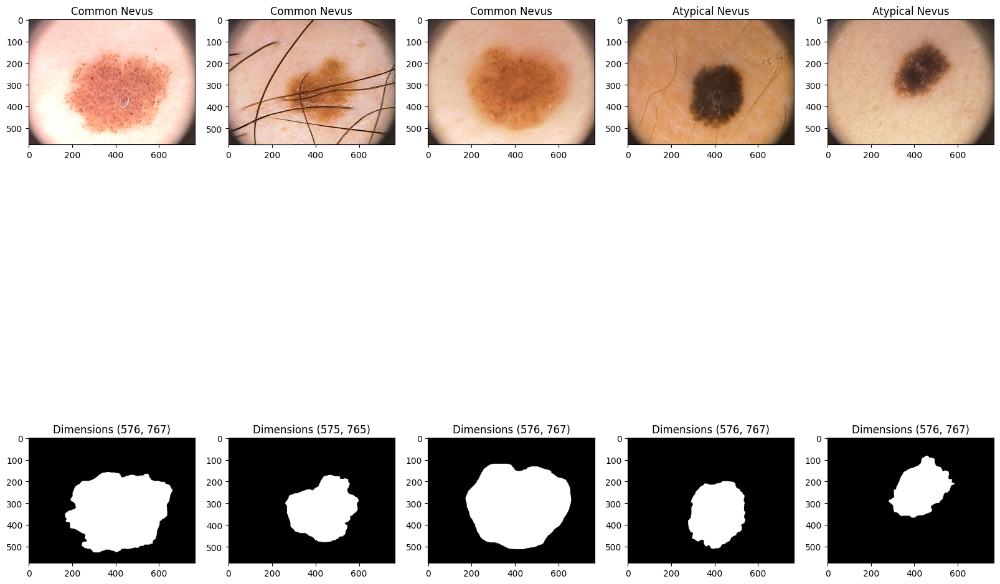

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(20,16))

for j in range(5):
    axes[0,j].imshow(images[j])
    axes[1,j].imshow(image_segmentations[j], cmap="gray")
    axes[0,j].set_title(labels[image_labels[j]])
    axes[1,j].set_title("Dimensions "+ str(image_segmentations[j].shape))

plt.show()

In [ ]:
IMG_SIZE = (224, 224)

def resize(img, IMG_SIZE=IMG_SIZE):
    return cv2.resize(img, IMG_SIZE, interpolation=cv2.INTER_AREA)

images_resized = [resize(img) for img in images]
image_segmentations_resized = [resize(img_segmentation) for img_segmentation in image_segmentations]

images_resized = [img/255.0 for img in images_resized]
image_segmentations_resized = [img/255.0 for img in image_segmentations_resized]

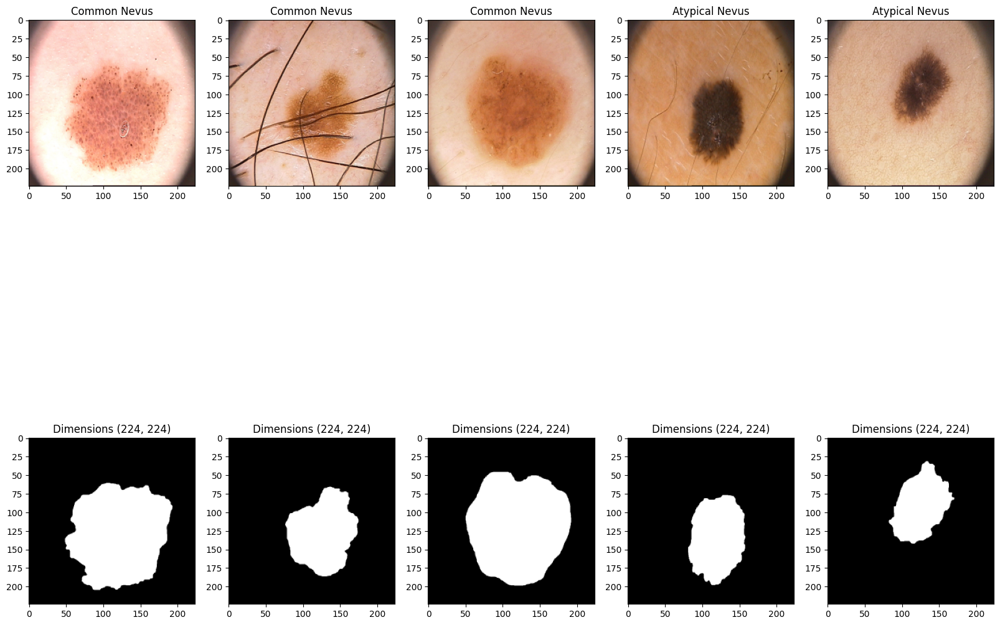

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(20,16))

for j in range(5):
    axes[0,j].imshow(images_resized[j])
    axes[1,j].imshow(image_segmentations_resized[j], cmap="gray")
    axes[0,j].set_title(labels[image_labels[j]])
    axes[1,j].set_title("Dimensions "+ str(image_segmentations_resized[j].shape))

plt.show()

In [ ]:
images_resized = np.array(images_resized)
image_segmentations_resized = np.array(image_segmentations_resized)
image_labels = np.array(image_labels)
X_train, X_test, Xseg_train, Xseg_test, y_train, y_test = train_test_split(images_resized, image_segmentations_resized, image_labels, test_size=.2)

In [ ]:
X_train.shape, Xseg_train.shape, y_train.shape

((160, 224, 224, 3), (160, 224, 224), (160,))

In [ ]:
def random_rotation(x_image, y_image):
    rows_x,cols_x, chl_x = x_image.shape
    rows_y,cols_y = y_image.shape
    rand_num = np.random.randint(-40,40)
    M1 = cv2.getRotationMatrix2D((cols_x/2,rows_x/2),rand_num,1)
    M2 = cv2.getRotationMatrix2D((cols_y/2,rows_y/2),rand_num,1)
    x_image = cv2.warpAffine(x_image,M1,(cols_x,rows_x))
    y_image = cv2.warpAffine(y_image.astype('float32'),M2,(cols_y,rows_y))
    return np.array(x_image), np.array(y_image.astype('int'))

def horizontal_flip(x_image, y_image):
    x_image = cv2.flip(x_image, 1)
    y_image = cv2.flip(y_image.astype('float32'), 1)
    return x_image, y_image.astype('int')

In [ ]:
def img_augmentation(x_train, seg_train, y_train):
    x_rotat = []
    seg_rotat = []
    x_flip = []
    seg_flip = []
    rotated_images_labels = []
    flipped_images_labels = []
    for idx in range(len(x_train)):
        x,seg = random_rotation(x_train[idx], seg_train[idx])
        x_rotat.append(x)
        seg_rotat.append(seg)

        x,seg = horizontal_flip(x_train[idx], seg_train[idx])
        x_flip.append(x)
        seg_flip.append(seg)

        rotated_images_labels.append(y_train[idx])
        flipped_images_labels.append(y_train[idx])

    return np.array(x_rotat), np.array(seg_rotat), np.array(x_flip), np.array(seg_flip), np.array(rotated_images_labels), np.array(flipped_images_labels)

In [ ]:
X_rotated, Xseg_rotated, X_flipped, Xseg_flipped, rotated_images_labels, flipped_images_labels = img_augmentation(X_train, Xseg_train, y_train)

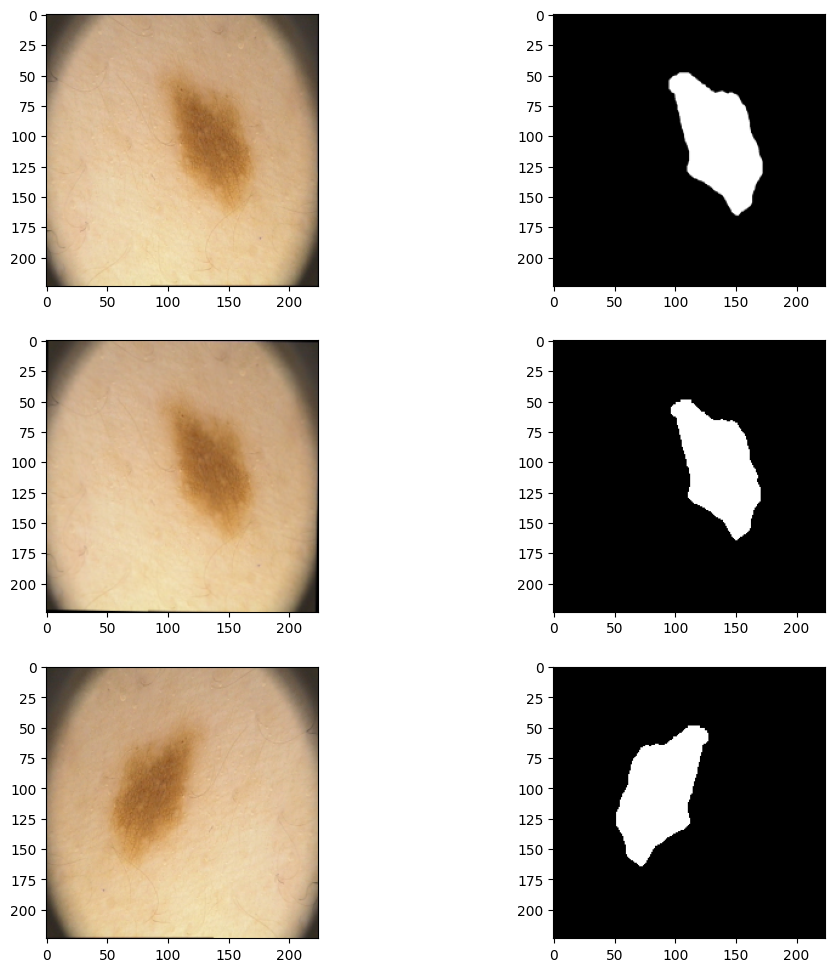

In [ ]:
plt.figure(figsize=(12,12))
plt.subplot(3,2,1)
plt.imshow(X_train[0])
plt.subplot(3,2,2)
plt.imshow(Xseg_train[0], cmap='gray')
plt.subplot(3,2,3)
plt.imshow(X_rotated[0])
plt.subplot(3,2,4)
plt.imshow(Xseg_rotated[0], cmap='gray')
plt.subplot(3,2,5)
plt.imshow(X_flipped[0])
plt.subplot(3,2,6)
plt.imshow(Xseg_flipped[0], cmap='gray')
plt.show()

In [ ]:
X_train = np.concatenate([X_train, X_rotated, X_flipped])
Xseg_train = np.concatenate([Xseg_train, Xseg_rotated, Xseg_flipped])
y_train = np.concatenate([y_train, rotated_images_labels, flipped_images_labels])

In [ ]:
X_train, X_val, seg_train, seg_val = train_test_split(X_train, Xseg_train, test_size = 0.20)

print("Taille du Training Set   : {}".format(len(X_train)))
print("Taille du Test Set       : {}".format(len(X_test)))
print("Taille du Validation Set : {}".format(len(X_val)))

Taille du Training Set   : 384
Taille du Test Set       : 40
Taille du Validation Set : 96


In [ ]:
seg_train = np.reshape(seg_train, (-1,224,224,1))
seg_val = np.reshape(seg_val, (-1,224,224,1))

## Attention U-Net

In [ ]:
def jaccard_distance(y_true, y_pred, smooth=100):
    y_true = tf.cast(y_true, tf.float32)
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    sum_ = K.sum(K.square(y_true), axis = -1) + K.sum(K.square(y_pred), axis=-1)
    jac = (intersection + smooth) / (sum_ - intersection + smooth)
    return (1 - jac)

def iou(y_pred, y_true, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, -1) + K.sum(y_pred, -1) - intersection
    iou = (intersection + smooth)/(union + smooth)
    return iou

def precision(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def recall(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def accuracy(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    return K.mean(K.equal(y_true, K.round(y_pred)))

def show_image(image, title=None, cmap=None, alpha=1):
    plt.imshow(image, cmap=cmap, alpha=alpha)
    if title is not None:
        plt.title(title)
    plt.axis('off')

def show_mask(image, mask, cmap=None, alpha=0.4):
    plt.imshow(image)
    plt.imshow(tf.squeeze(mask), cmap=cmap, alpha=alpha)
    plt.axis('off')

In [ ]:
class EncoderBlock(keras.layers.Layer):

    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(EncoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate
        self.pooling = pooling

        self.c1 = keras.layers.Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.drop = keras.layers.Dropout(rate)
        self.c2 = keras.layers.Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.pool = keras.layers.MaxPool2D()

    def call(self, X):
        x = self.c1(X)
        x = self.drop(x)
        x = self.c2(x)
        if self.pooling:
            y = self.pool(x)
            return y, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
            'pooling':self.pooling
        }

class DecoderBlock(keras.layers.Layer):

    def __init__(self, filters, rate, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate

        self.up = keras.layers.UpSampling2D()
        self.net = EncoderBlock(filters, rate, pooling=False)

    def call(self, X):
        X, skip_X = X
        x = self.up(X)
        c_ = keras.layers.concatenate([x, skip_X])
        x = self.net(c_)
        return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
        }


class AttentionGate(keras.layers.Layer):

    def __init__(self, filters, bn, **kwargs):
        super(AttentionGate, self).__init__(**kwargs)

        self.filters = filters
        self.bn = bn

        self.normal = keras.layers.Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer='he_normal')
        self.down = keras.layers.Conv2D(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.learn = keras.layers.Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')
        self.resample = keras.layers.UpSampling2D()
        self.BN = keras.layers.BatchNormalization()

    def call(self, X):
        X, skip_X = X

        x = self.normal(X)
        skip = self.down(skip_X)
        x = keras.layers.Add()([x, skip])
        x = self.learn(x)
        x = self.resample(x)
        f = keras.layers.Multiply()([x, skip_X])
        if self.bn:
            return self.BN(f)
        else:
            return f
        # return f

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "bn":self.bn
        }

class ShowProgress(keras.callbacks.Callback):
    def on_epoch_end(self, epochs, logs=None):
        id = np.random.randint(200)
        exp = GradCAM()
        image = X_train[id]
        mask = seg_train[id]
        pred_mask = self.model.predict(image[np.newaxis,...])
        cam = exp.explain(
            validation_data=(image[np.newaxis,...], mask),
            class_index=1,
            layer_name='Attention4',
            model=self.model
        )

        plt.figure(figsize=(10,5))

        plt.subplot(1,3,1)
        plt.title("Original Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1,3,2)
        plt.title("Predicted Mask")
        show_mask(image, pred_mask, cmap='copper')

        plt.subplot(1,3,3)
        show_image(cam,title="GradCAM")

        plt.tight_layout()
        plt.show()

In [ ]:
input_layer = keras.layers.Input(shape=(224,224,3))
p1, c1 = EncoderBlock(32,0.1, name="Encoder1")(input_layer)
p2, c2 = EncoderBlock(64,0.1, name="Encoder2")(p1)
p3, c3 = EncoderBlock(128,0.2, name="Encoder3")(p2)
p4, c4 = EncoderBlock(256,0.2, name="Encoder4")(p3)
encoding = EncoderBlock(512,0.3, pooling=False, name="Encoding")(p4)
a1 = AttentionGate(256, bn=True, name="Attention1")([encoding, c4])
d1 = DecoderBlock(256,0.2, name="Decoder1")([encoding, a1])
a2 = AttentionGate(128, bn=True, name="Attention2")([d1, c3])
d2 = DecoderBlock(128,0.2, name="Decoder2")([d1, a2])
a3 = AttentionGate(64, bn=True, name="Attention3")([d2, c2])
d3 = DecoderBlock(64,0.1, name="Decoder3")([d2, a3])
a4 = AttentionGate(32, bn=True, name="Attention4")([d3, c1])
d4 = DecoderBlock(32,0.1, name="Decoder4")([d3, a4])
output_layer = keras.layers.Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(d4)
model = keras.models.Model(
    inputs=[input_layer],
    outputs=[output_layer]
)
model.compile(
    loss=[jaccard_distance],
    optimizer='adam',
    metrics=[accuracy, precision, recall, iou]
)
cb = [
    keras.callbacks.ModelCheckpoint("AttentionCustomUNet.h5", save_best_only=True),
    ShowProgress()
]

Epoch 1/45
 6/48 [==>...........................] - ETA: 8s - loss: 0.0025 - accuracy: 0.6278 - precision: 0.4142 - recall: 0.0734 - iou: 0.7793

1/1 [==============================] - 2s 2s/step


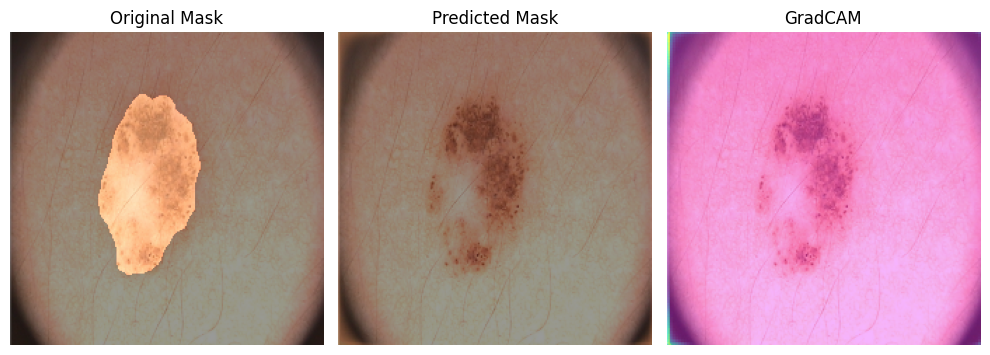


48/48 [==============================] - 46s 442ms/step - loss: 0.0011 - accuracy: 0.8468 - precision: 0.7864 - recall: 0.6807 - iou: 0.8803 - val_loss: 0.0027 - val_accuracy: 0.6948 - val_precision: 0.6981 - val_recall: 0.0407 - val_iou: 0.8438
Epoch 2/45
1/1 [==============================] - 0s 21ms/step


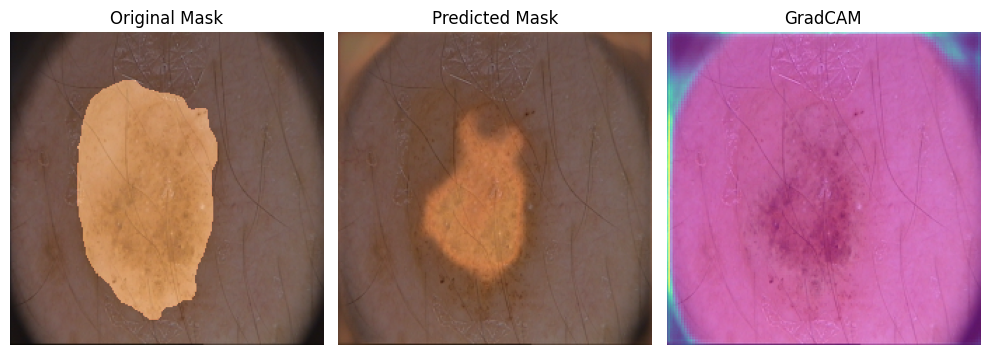


48/48 [==============================] - 13s 268ms/step - loss: 7.1954e-04 - accuracy: 0.9031 - precision: 0.8776 - recall: 0.8216 - iou: 0.9174 - val_loss: 0.0020 - val_accuracy: 0.7682 - val_precision: 0.8354 - val_recall: 0.3381 - val_iou: 0.8723
Epoch 3/45
1/1 [==============================] - 0s 21ms/step


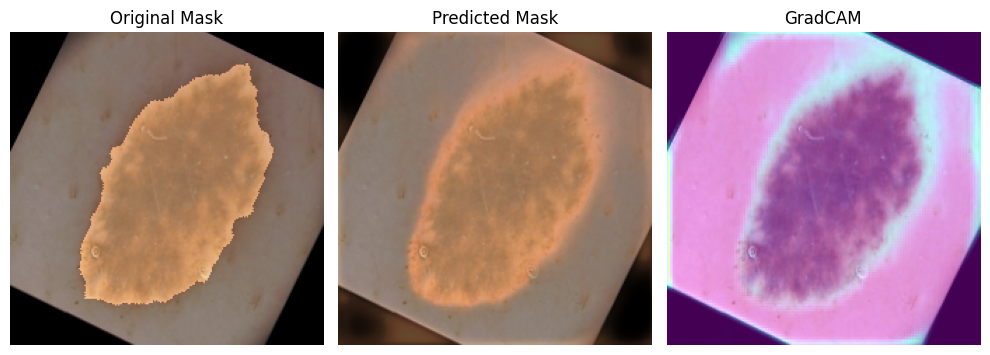


48/48 [==============================] - 12s 251ms/step - loss: 6.9301e-04 - accuracy: 0.9071 - precision: 0.8824 - recall: 0.8439 - iou: 0.9196 - val_loss: 0.0017 - val_accuracy: 0.7119 - val_precision: 0.5229 - val_recall: 0.9698 - val_iou: 0.8058
Epoch 4/45
1/1 [==============================] - 0s 29ms/step


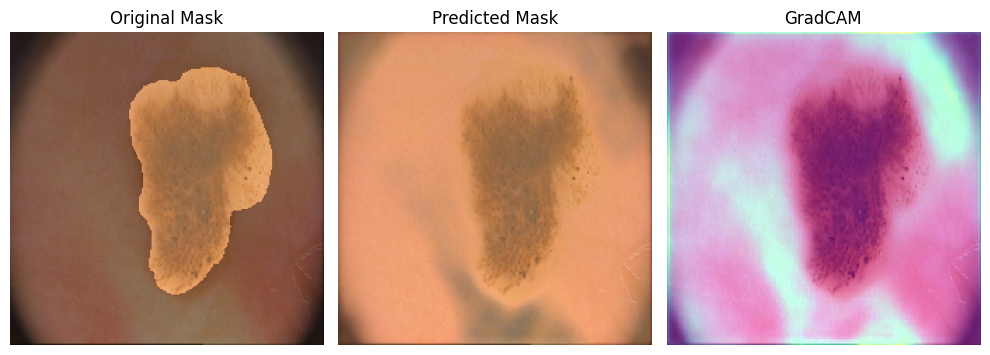


48/48 [==============================] - 12s 259ms/step - loss: 6.3870e-04 - accuracy: 0.9133 - precision: 0.8949 - recall: 0.8393 - iou: 0.9284 - val_loss: 0.0017 - val_accuracy: 0.7514 - val_precision: 0.5646 - val_recall: 0.9650 - val_iou: 0.8218
Epoch 5/45
1/1 [==============================] - 0s 28ms/step


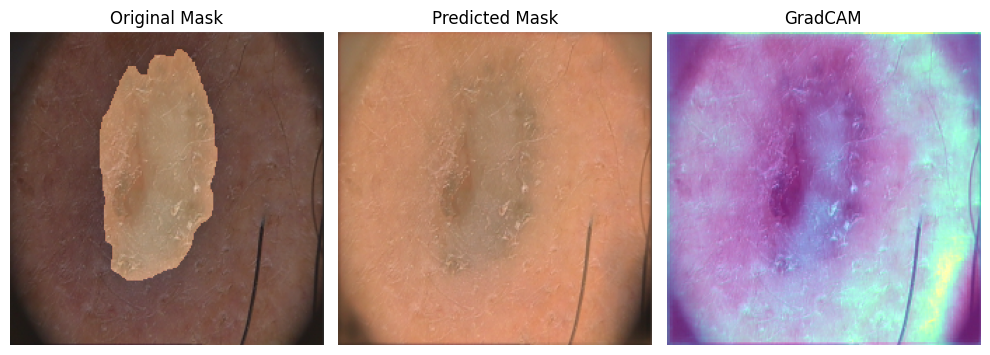


48/48 [==============================] - 12s 257ms/step - loss: 5.6571e-04 - accuracy: 0.9225 - precision: 0.8995 - recall: 0.8603 - iou: 0.9332 - val_loss: 0.0014 - val_accuracy: 0.7970 - val_precision: 0.6143 - val_recall: 0.9709 - val_iou: 0.8261
Epoch 6/45
1/1 [==============================] - 0s 21ms/step


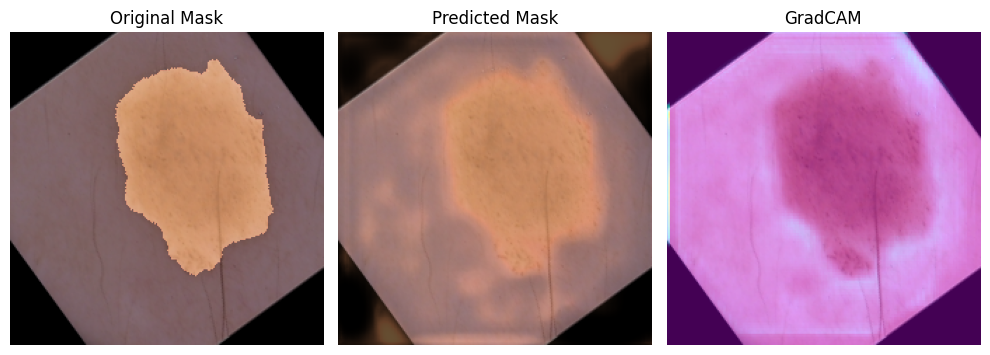


48/48 [==============================] - 12s 255ms/step - loss: 5.3670e-04 - accuracy: 0.9263 - precision: 0.9014 - recall: 0.8768 - iou: 0.9392 - val_loss: 0.0012 - val_accuracy: 0.8262 - val_precision: 0.6661 - val_recall: 0.9176 - val_iou: 0.8434
Epoch 7/45
1/1 [==============================] - 0s 21ms/step


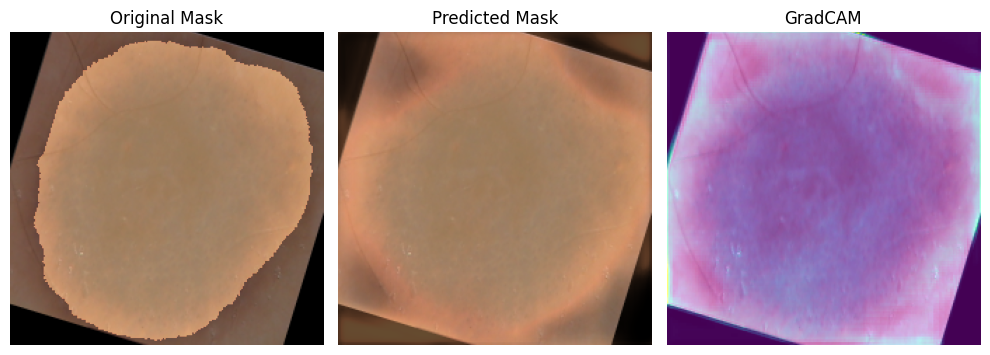


48/48 [==============================] - 12s 254ms/step - loss: 5.2412e-04 - accuracy: 0.9286 - precision: 0.9025 - recall: 0.8786 - iou: 0.9384 - val_loss: 9.3339e-04 - val_accuracy: 0.8748 - val_precision: 0.7724 - val_recall: 0.8594 - val_iou: 0.8986
Epoch 8/45
1/1 [==============================] - 0s 21ms/step


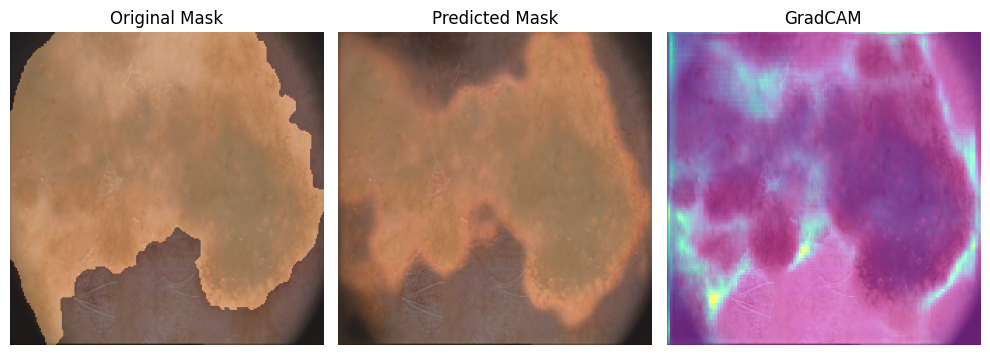


48/48 [==============================] - 12s 256ms/step - loss: 5.7533e-04 - accuracy: 0.9220 - precision: 0.8976 - recall: 0.8670 - iou: 0.9332 - val_loss: 6.6436e-04 - val_accuracy: 0.9135 - val_precision: 0.9392 - val_recall: 0.7932 - val_iou: 0.9416
Epoch 9/45
1/1 [==============================] - 0s 29ms/step


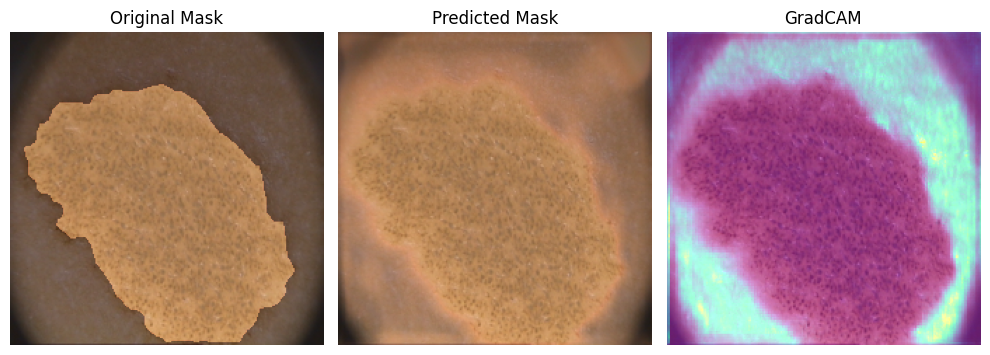


48/48 [==============================] - 12s 250ms/step - loss: 5.2309e-04 - accuracy: 0.9290 - precision: 0.9043 - recall: 0.8792 - iou: 0.9399 - val_loss: 0.0014 - val_accuracy: 0.7925 - val_precision: 0.6039 - val_recall: 0.9765 - val_iou: 0.8473
Epoch 10/45
1/1 [==============================] - 0s 33ms/step


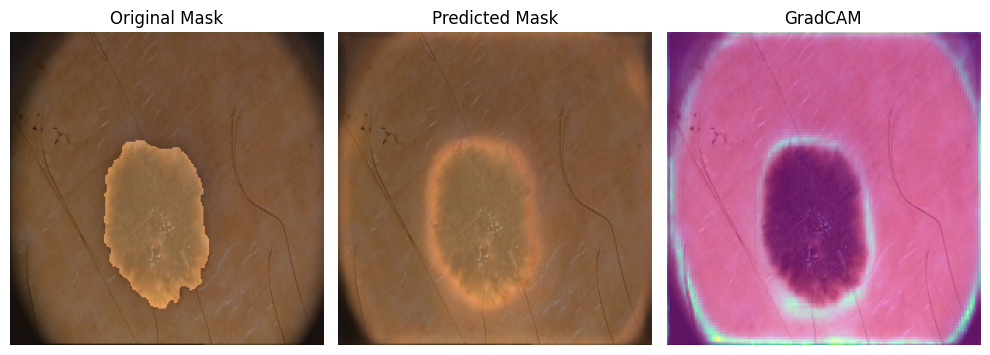


48/48 [==============================] - 13s 281ms/step - loss: 4.4158e-04 - accuracy: 0.9390 - precision: 0.9192 - recall: 0.8924 - iou: 0.9499 - val_loss: 5.4179e-04 - val_accuracy: 0.9288 - val_precision: 0.9225 - val_recall: 0.8567 - val_iou: 0.9264
Epoch 11/45
1/1 [==============================] - 0s 29ms/step


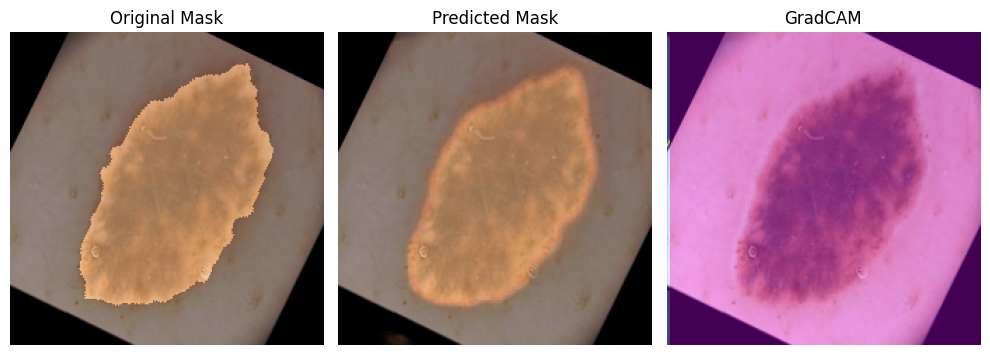


48/48 [==============================] - 12s 242ms/step - loss: 4.3541e-04 - accuracy: 0.9401 - precision: 0.9171 - recall: 0.9028 - iou: 0.9480 - val_loss: 5.7310e-04 - val_accuracy: 0.9243 - val_precision: 0.8796 - val_recall: 0.8975 - val_iou: 0.9314
Epoch 12/45
1/1 [==============================] - 0s 21ms/step


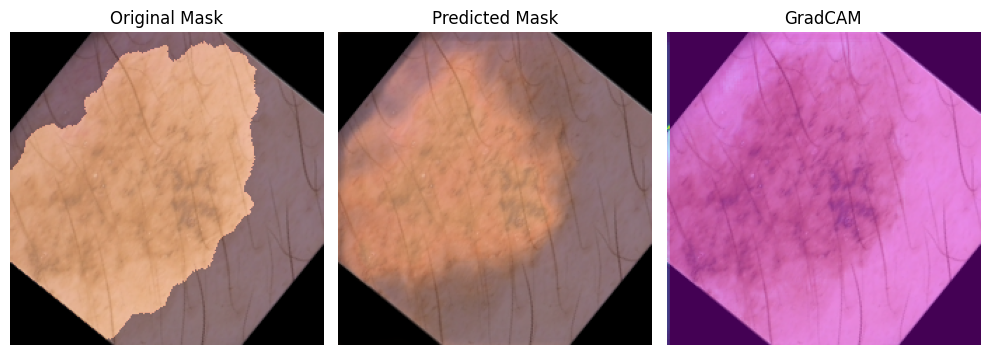


48/48 [==============================] - 14s 290ms/step - loss: 4.3277e-04 - accuracy: 0.9401 - precision: 0.9210 - recall: 0.8957 - iou: 0.9504 - val_loss: 5.3107e-04 - val_accuracy: 0.9300 - val_precision: 0.8979 - val_recall: 0.8882 - val_iou: 0.9319
Epoch 13/45
1/1 [==============================] - 0s 21ms/step


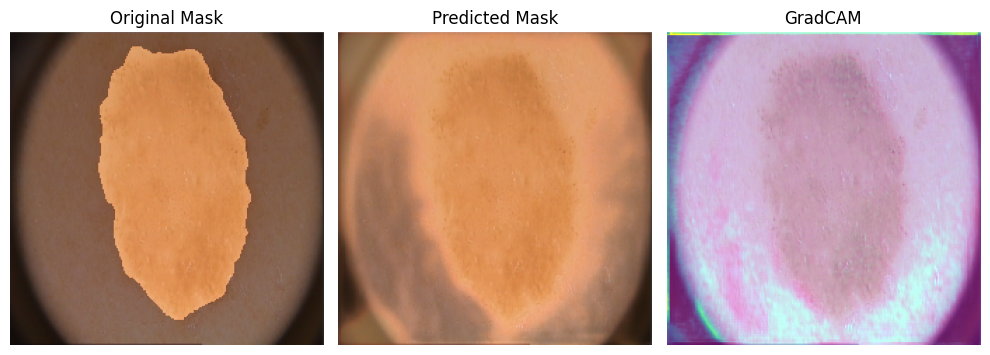


48/48 [==============================] - 12s 244ms/step - loss: 4.1477e-04 - accuracy: 0.9422 - precision: 0.9246 - recall: 0.8997 - iou: 0.9520 - val_loss: 0.0016 - val_accuracy: 0.7945 - val_precision: 0.6089 - val_recall: 0.9838 - val_iou: 0.8431
Epoch 14/45
1/1 [==============================] - 0s 30ms/step


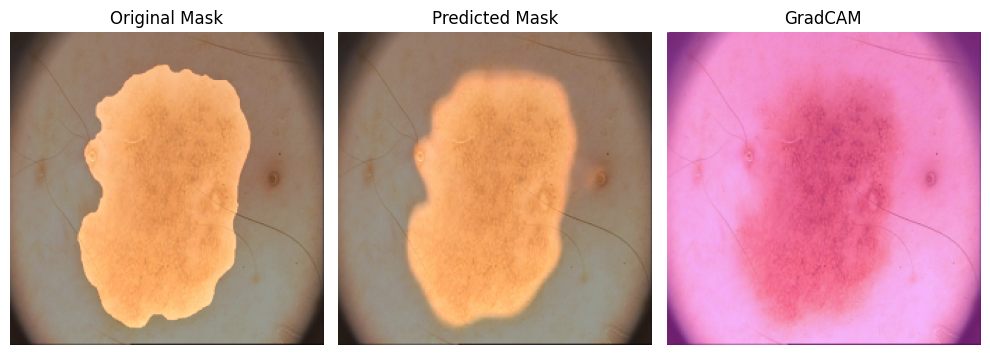


48/48 [==============================] - 12s 246ms/step - loss: 3.9790e-04 - accuracy: 0.9446 - precision: 0.9194 - recall: 0.9094 - iou: 0.9533 - val_loss: 5.8363e-04 - val_accuracy: 0.9196 - val_precision: 0.8360 - val_recall: 0.9371 - val_iou: 0.9349
Epoch 15/45
1/1 [==============================] - 0s 20ms/step


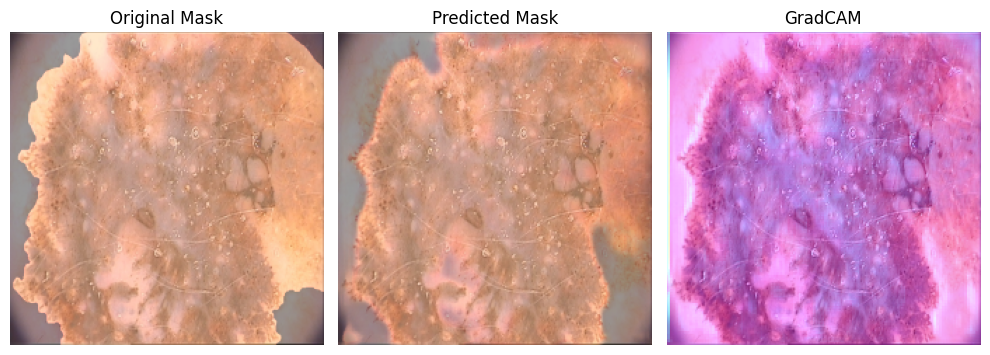


48/48 [==============================] - 13s 277ms/step - loss: 4.1091e-04 - accuracy: 0.9429 - precision: 0.9199 - recall: 0.9055 - iou: 0.9517 - val_loss: 5.2485e-04 - val_accuracy: 0.9316 - val_precision: 0.8558 - val_recall: 0.9479 - val_iou: 0.9188
Epoch 16/45
1/1 [==============================] - 0s 22ms/step


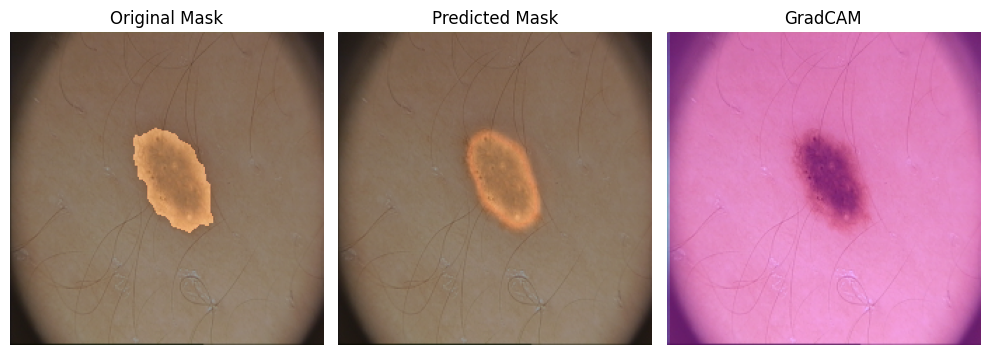


48/48 [==============================] - 12s 243ms/step - loss: 3.6767e-04 - accuracy: 0.9484 - precision: 0.9250 - recall: 0.9167 - iou: 0.9569 - val_loss: 5.5715e-04 - val_accuracy: 0.9258 - val_precision: 0.9603 - val_recall: 0.8121 - val_iou: 0.9503
Epoch 17/45
1/1 [==============================] - 0s 21ms/step


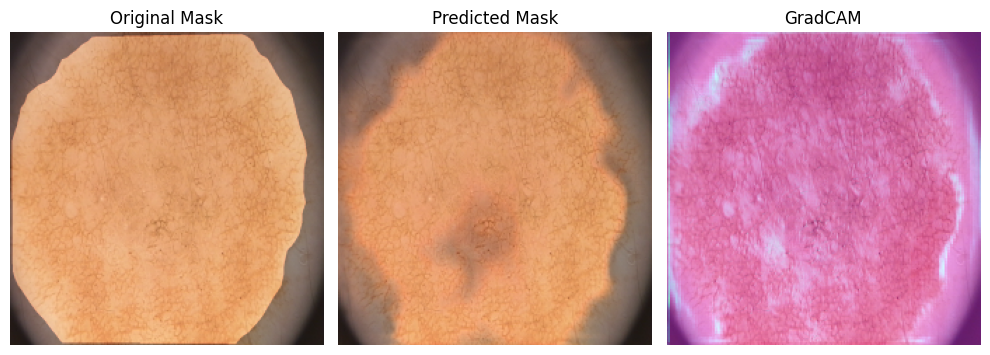


48/48 [==============================] - 13s 277ms/step - loss: 3.2374e-04 - accuracy: 0.9539 - precision: 0.9354 - recall: 0.9234 - iou: 0.9620 - val_loss: 4.8234e-04 - val_accuracy: 0.9344 - val_precision: 0.9220 - val_recall: 0.8767 - val_iou: 0.9505
Epoch 18/45
1/1 [==============================] - 0s 35ms/step


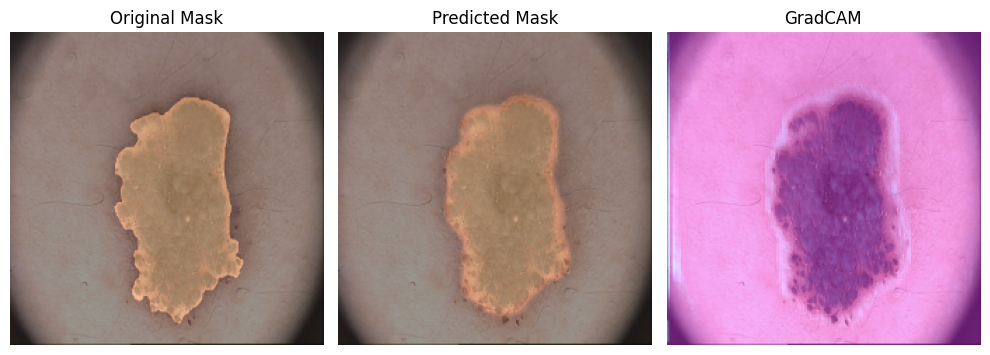


48/48 [==============================] - 14s 286ms/step - loss: 3.3690e-04 - accuracy: 0.9526 - precision: 0.9327 - recall: 0.9228 - iou: 0.9604 - val_loss: 4.4564e-04 - val_accuracy: 0.9391 - val_precision: 0.9043 - val_recall: 0.9131 - val_iou: 0.9502
Epoch 19/45
1/1 [==============================] - 0s 29ms/step


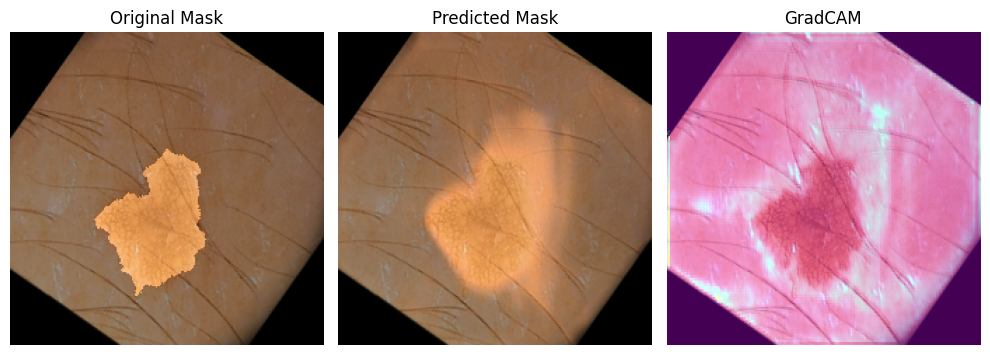


48/48 [==============================] - 12s 251ms/step - loss: 3.2627e-04 - accuracy: 0.9538 - precision: 0.9313 - recall: 0.9250 - iou: 0.9623 - val_loss: 5.2902e-04 - val_accuracy: 0.9252 - val_precision: 0.8615 - val_recall: 0.9244 - val_iou: 0.9341
Epoch 20/45
1/1 [==============================] - 0s 21ms/step


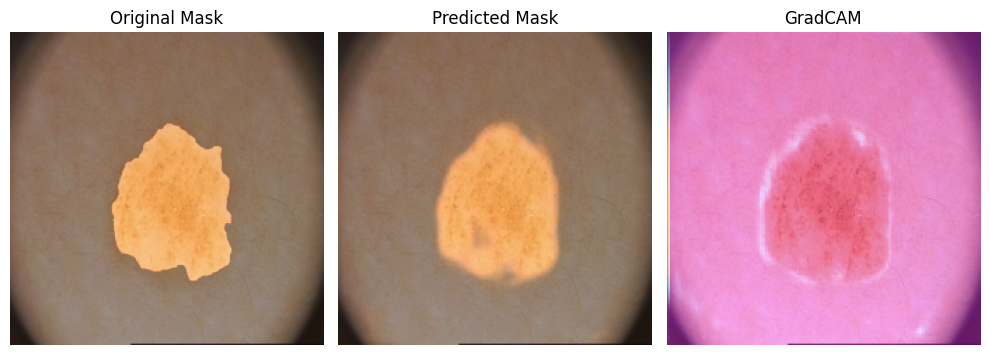


48/48 [==============================] - 13s 275ms/step - loss: 3.5141e-04 - accuracy: 0.9507 - precision: 0.9299 - recall: 0.9217 - iou: 0.9603 - val_loss: 4.1090e-04 - val_accuracy: 0.9419 - val_precision: 0.8751 - val_recall: 0.9474 - val_iou: 0.9436
Epoch 21/45
1/1 [==============================] - 0s 22ms/step


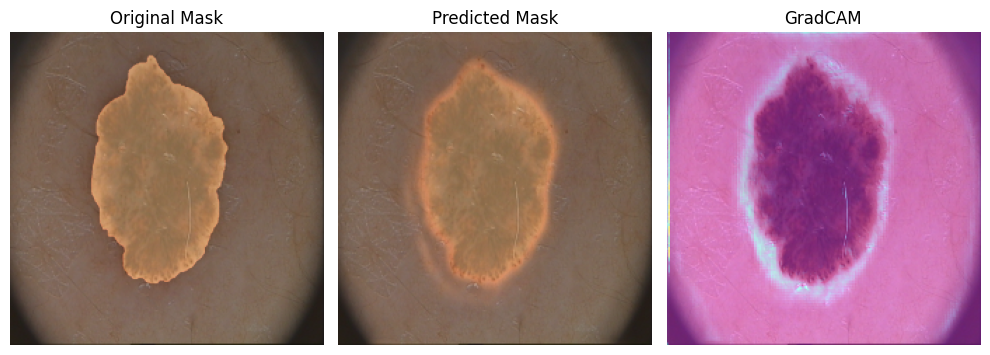


48/48 [==============================] - 12s 245ms/step - loss: 3.4115e-04 - accuracy: 0.9522 - precision: 0.9316 - recall: 0.9255 - iou: 0.9606 - val_loss: 5.4272e-04 - val_accuracy: 0.9269 - val_precision: 0.8624 - val_recall: 0.9310 - val_iou: 0.9388
Epoch 22/45
1/1 [==============================] - 0s 31ms/step


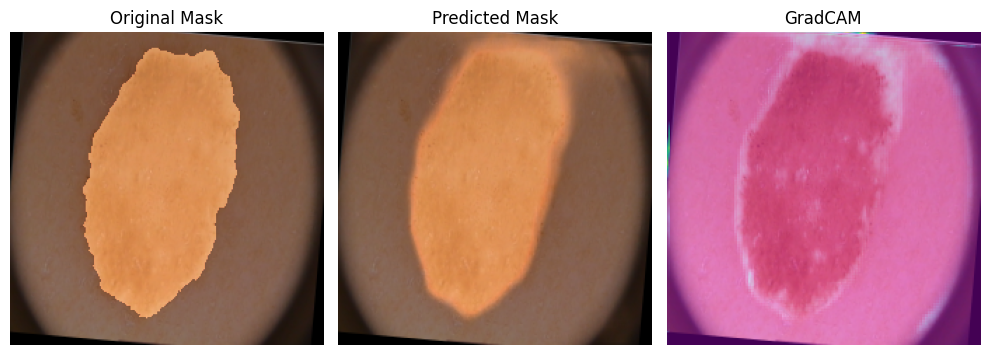


48/48 [==============================] - 12s 248ms/step - loss: 2.9294e-04 - accuracy: 0.9577 - precision: 0.9373 - recall: 0.9327 - iou: 0.9640 - val_loss: 4.2950e-04 - val_accuracy: 0.9426 - val_precision: 0.9427 - val_recall: 0.8832 - val_iou: 0.9613
Epoch 23/45
1/1 [==============================] - 0s 21ms/step


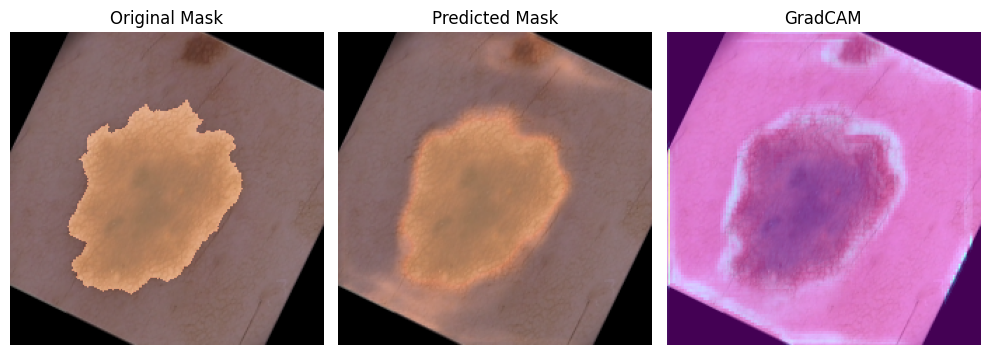


48/48 [==============================] - 12s 243ms/step - loss: 3.3055e-04 - accuracy: 0.9534 - precision: 0.9278 - recall: 0.9281 - iou: 0.9621 - val_loss: 5.9882e-04 - val_accuracy: 0.9151 - val_precision: 0.8169 - val_recall: 0.9468 - val_iou: 0.9362
Epoch 24/45
1/1 [==============================] - 0s 20ms/step


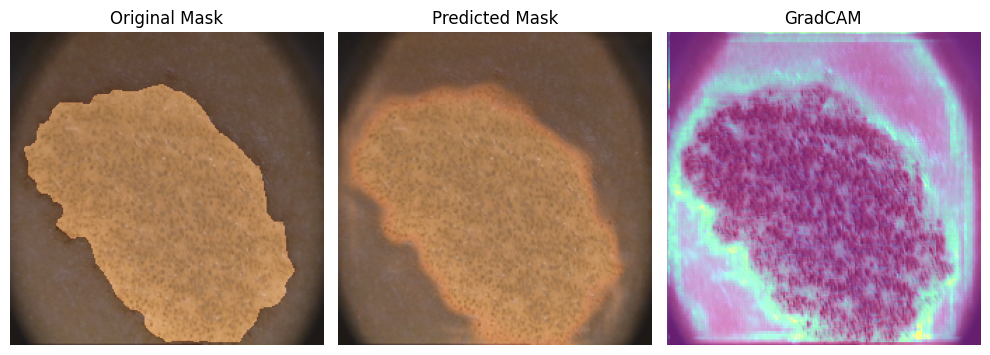


48/48 [==============================] - 12s 246ms/step - loss: 2.9554e-04 - accuracy: 0.9576 - precision: 0.9408 - recall: 0.9286 - iou: 0.9660 - val_loss: 4.2994e-04 - val_accuracy: 0.9361 - val_precision: 0.8686 - val_recall: 0.9358 - val_iou: 0.9440
Epoch 25/45
1/1 [==============================] - 0s 40ms/step


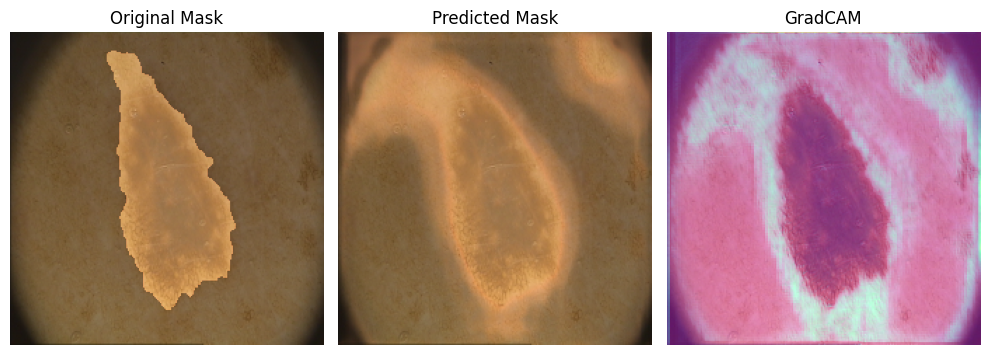


48/48 [==============================] - 12s 249ms/step - loss: 2.6046e-04 - accuracy: 0.9619 - precision: 0.9408 - recall: 0.9441 - iou: 0.9697 - val_loss: 5.2832e-04 - val_accuracy: 0.9252 - val_precision: 0.8384 - val_recall: 0.9537 - val_iou: 0.9445
Epoch 26/45
1/1 [==============================] - 0s 20ms/step


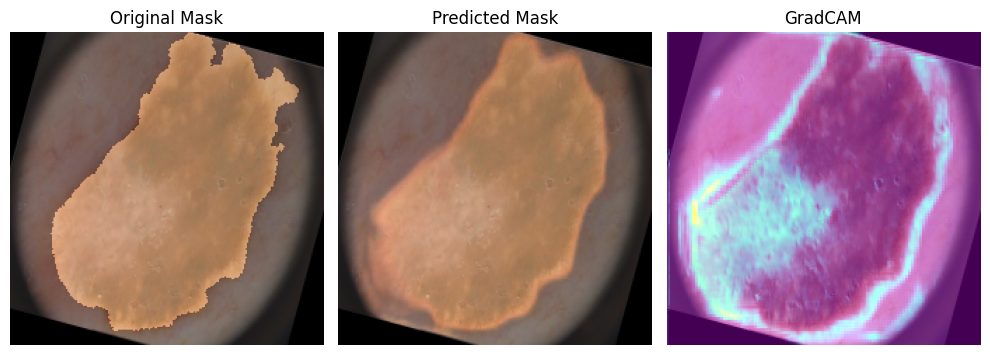


48/48 [==============================] - 13s 277ms/step - loss: 2.3612e-04 - accuracy: 0.9651 - precision: 0.9440 - recall: 0.9470 - iou: 0.9715 - val_loss: 2.9173e-04 - val_accuracy: 0.9591 - val_precision: 0.9570 - val_recall: 0.9173 - val_iou: 0.9683
Epoch 27/45
1/1 [==============================] - 0s 29ms/step


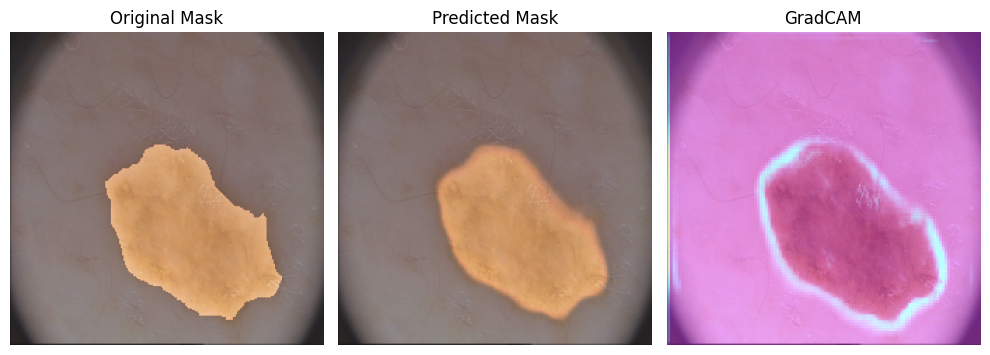


48/48 [==============================] - 12s 247ms/step - loss: 2.3155e-04 - accuracy: 0.9656 - precision: 0.9455 - recall: 0.9491 - iou: 0.9723 - val_loss: 3.0207e-04 - val_accuracy: 0.9580 - val_precision: 0.9768 - val_recall: 0.8932 - val_iou: 0.9685
Epoch 28/45
1/1 [==============================] - 0s 28ms/step


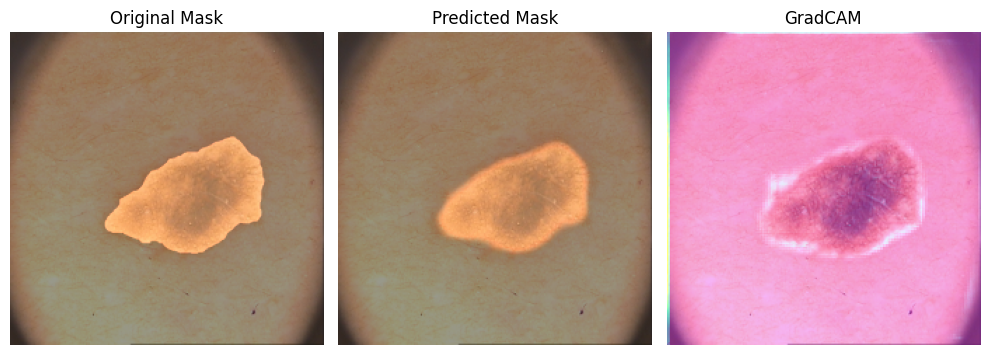


48/48 [==============================] - 12s 247ms/step - loss: 2.3482e-04 - accuracy: 0.9650 - precision: 0.9478 - recall: 0.9463 - iou: 0.9718 - val_loss: 2.9725e-04 - val_accuracy: 0.9575 - val_precision: 0.9294 - val_recall: 0.9412 - val_iou: 0.9692
Epoch 29/45
1/1 [==============================] - 0s 29ms/step


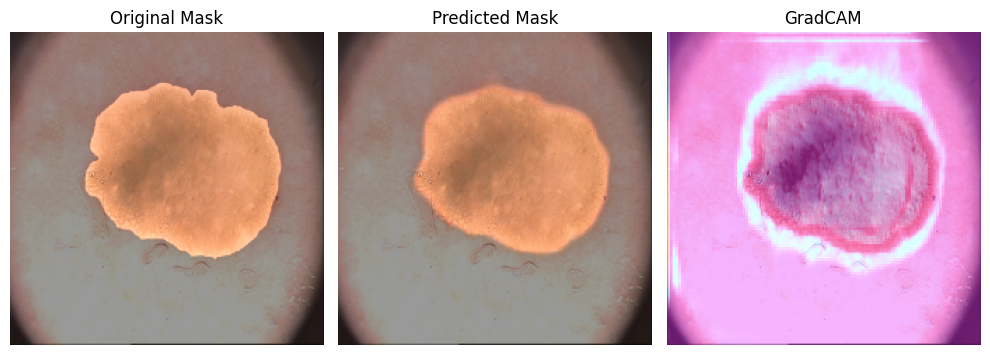


48/48 [==============================] - 12s 251ms/step - loss: 2.1159e-04 - accuracy: 0.9685 - precision: 0.9484 - recall: 0.9535 - iou: 0.9749 - val_loss: 3.5411e-04 - val_accuracy: 0.9495 - val_precision: 0.9031 - val_recall: 0.9496 - val_iou: 0.9602
Epoch 30/45
1/1 [==============================] - 0s 29ms/step


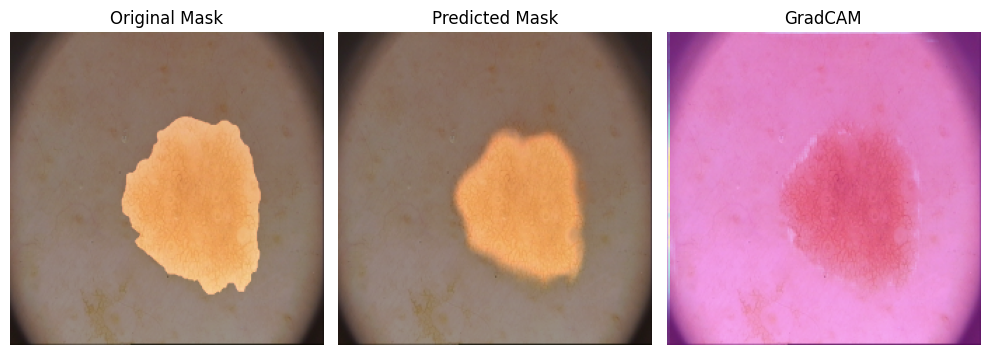


48/48 [==============================] - 12s 246ms/step - loss: 2.0272e-04 - accuracy: 0.9696 - precision: 0.9509 - recall: 0.9548 - iou: 0.9757 - val_loss: 3.0290e-04 - val_accuracy: 0.9573 - val_precision: 0.9545 - val_recall: 0.9140 - val_iou: 0.9690
Epoch 31/45
1/1 [==============================] - 0s 56ms/step


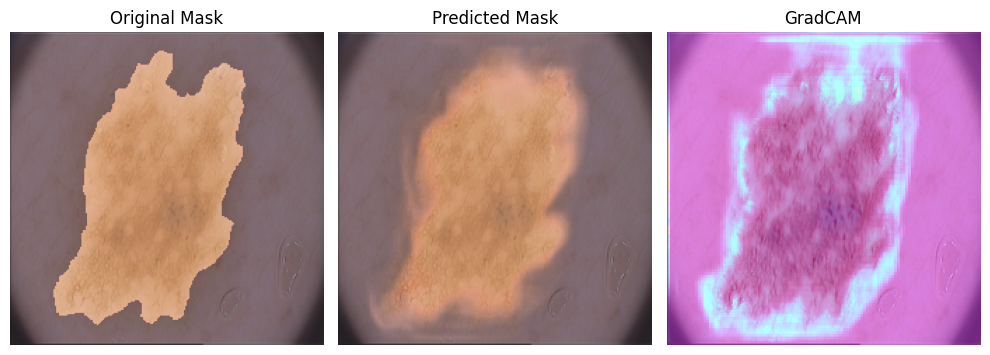


48/48 [==============================] - 12s 250ms/step - loss: 2.3328e-04 - accuracy: 0.9658 - precision: 0.9494 - recall: 0.9467 - iou: 0.9735 - val_loss: 3.5149e-04 - val_accuracy: 0.9502 - val_precision: 0.9528 - val_recall: 0.8903 - val_iou: 0.9615
Epoch 32/45
1/1 [==============================] - 0s 21ms/step


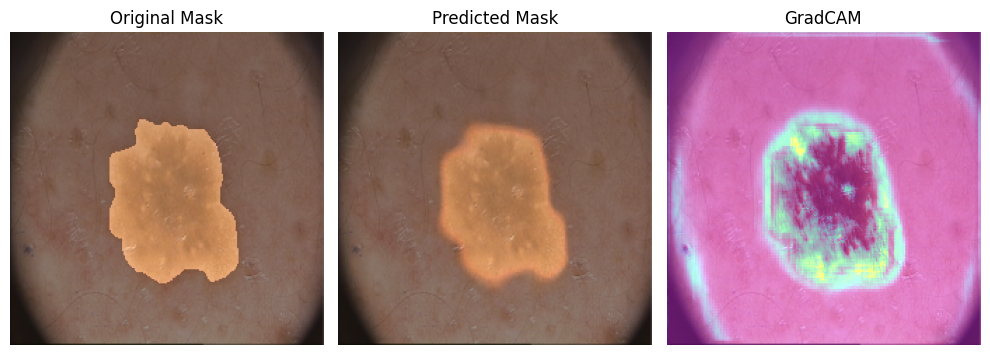


48/48 [==============================] - 13s 275ms/step - loss: 2.4285e-04 - accuracy: 0.9648 - precision: 0.9473 - recall: 0.9450 - iou: 0.9704 - val_loss: 2.7740e-04 - val_accuracy: 0.9597 - val_precision: 0.9310 - val_recall: 0.9454 - val_iou: 0.9627
Epoch 33/45
1/1 [==============================] - 0s 30ms/step


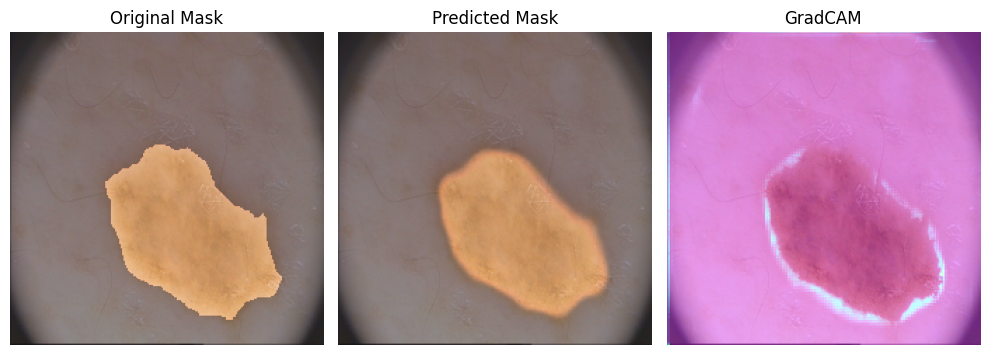


48/48 [==============================] - 12s 249ms/step - loss: 2.1634e-04 - accuracy: 0.9680 - precision: 0.9484 - recall: 0.9535 - iou: 0.9743 - val_loss: 3.2161e-04 - val_accuracy: 0.9548 - val_precision: 0.9608 - val_recall: 0.8986 - val_iou: 0.9691
Epoch 34/45
1/1 [==============================] - 0s 41ms/step


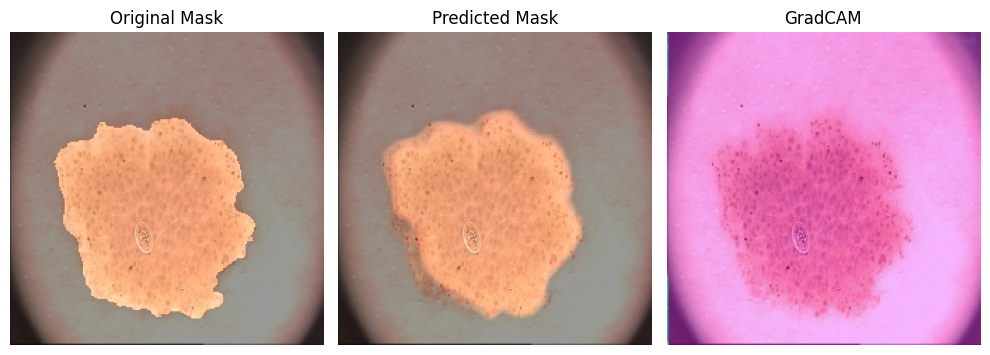


48/48 [==============================] - 12s 249ms/step - loss: 2.0689e-04 - accuracy: 0.9694 - precision: 0.9519 - recall: 0.9537 - iou: 0.9752 - val_loss: 4.9693e-04 - val_accuracy: 0.9372 - val_precision: 0.9814 - val_recall: 0.8283 - val_iou: 0.9627
Epoch 35/45
1/1 [==============================] - 0s 23ms/step


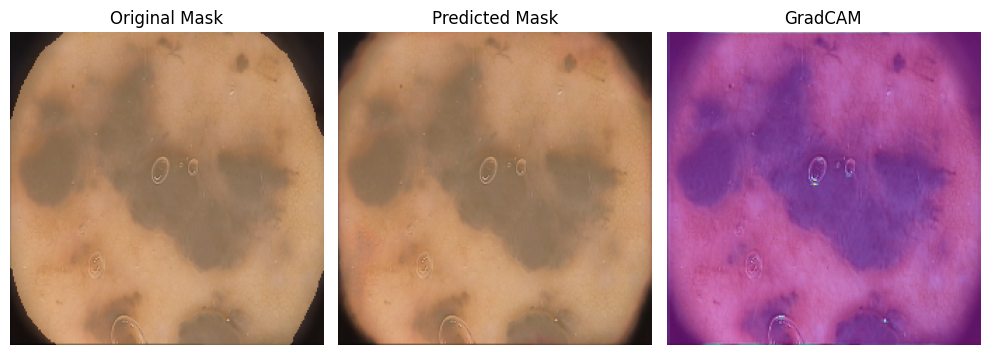


48/48 [==============================] - 13s 277ms/step - loss: 2.1587e-04 - accuracy: 0.9682 - precision: 0.9511 - recall: 0.9514 - iou: 0.9749 - val_loss: 2.7663e-04 - val_accuracy: 0.9603 - val_precision: 0.9229 - val_recall: 0.9582 - val_iou: 0.9671
Epoch 36/45
1/1 [==============================] - 0s 33ms/step


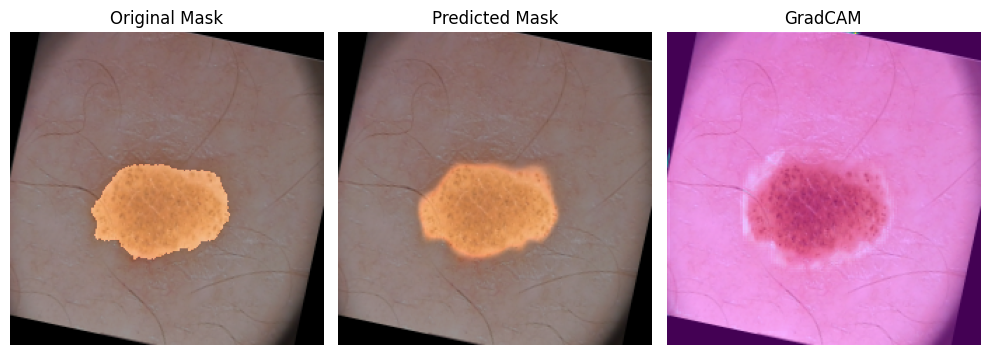


48/48 [==============================] - 12s 248ms/step - loss: 1.7733e-04 - accuracy: 0.9730 - precision: 0.9561 - recall: 0.9599 - iou: 0.9789 - val_loss: 3.7121e-04 - val_accuracy: 0.9478 - val_precision: 0.8951 - val_recall: 0.9542 - val_iou: 0.9642
Epoch 37/45
1/1 [==============================] - 0s 41ms/step


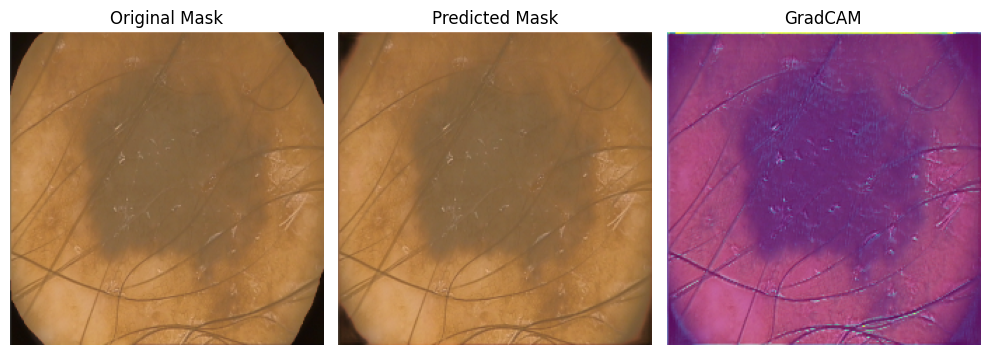


48/48 [==============================] - 12s 252ms/step - loss: 1.6628e-04 - accuracy: 0.9745 - precision: 0.9591 - recall: 0.9615 - iou: 0.9799 - val_loss: 2.8220e-04 - val_accuracy: 0.9615 - val_precision: 0.9716 - val_recall: 0.9096 - val_iou: 0.9750
Epoch 38/45
1/1 [==============================] - 0s 29ms/step


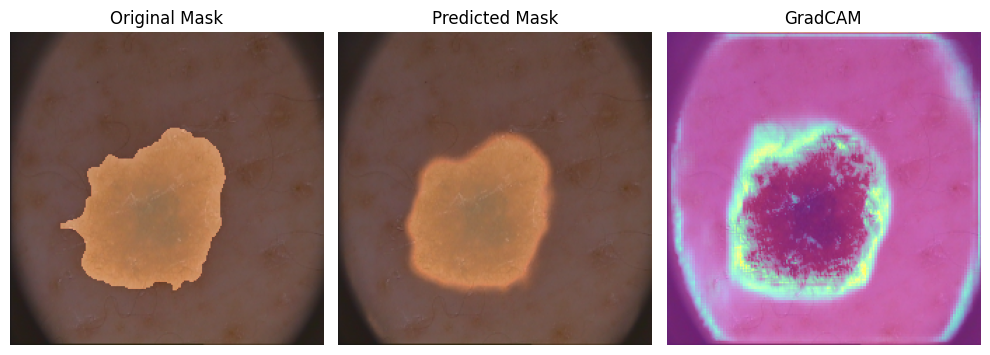


48/48 [==============================] - 12s 248ms/step - loss: 1.6415e-04 - accuracy: 0.9747 - precision: 0.9585 - recall: 0.9628 - iou: 0.9799 - val_loss: 2.8326e-04 - val_accuracy: 0.9602 - val_precision: 0.9504 - val_recall: 0.9299 - val_iou: 0.9724
Epoch 39/45
1/1 [==============================] - 0s 31ms/step


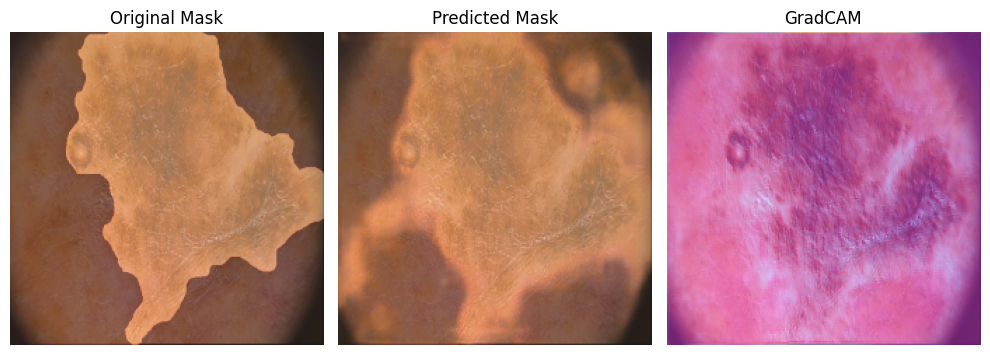


48/48 [==============================] - 14s 287ms/step - loss: 1.6012e-04 - accuracy: 0.9753 - precision: 0.9590 - recall: 0.9640 - iou: 0.9806 - val_loss: 2.7009e-04 - val_accuracy: 0.9617 - val_precision: 0.9494 - val_recall: 0.9346 - val_iou: 0.9727
Epoch 40/45
1/1 [==============================] - 0s 46ms/step


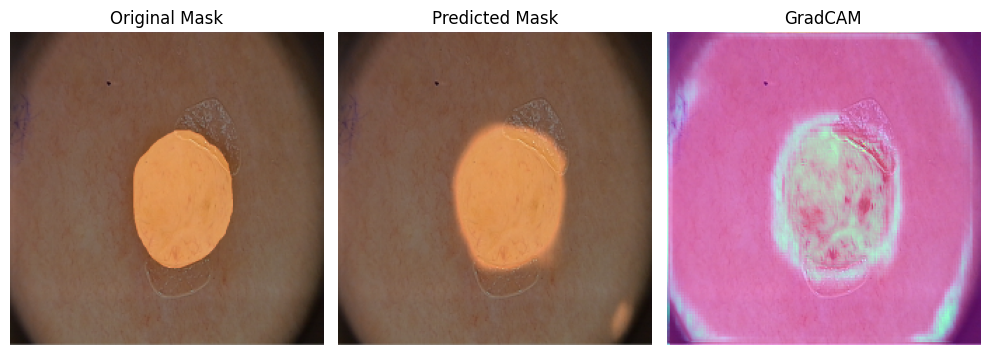


48/48 [==============================] - 12s 253ms/step - loss: 1.6604e-04 - accuracy: 0.9745 - precision: 0.9612 - recall: 0.9614 - iou: 0.9802 - val_loss: 2.9715e-04 - val_accuracy: 0.9579 - val_precision: 0.9277 - val_recall: 0.9467 - val_iou: 0.9701
Epoch 41/45
1/1 [==============================] - 0s 37ms/step


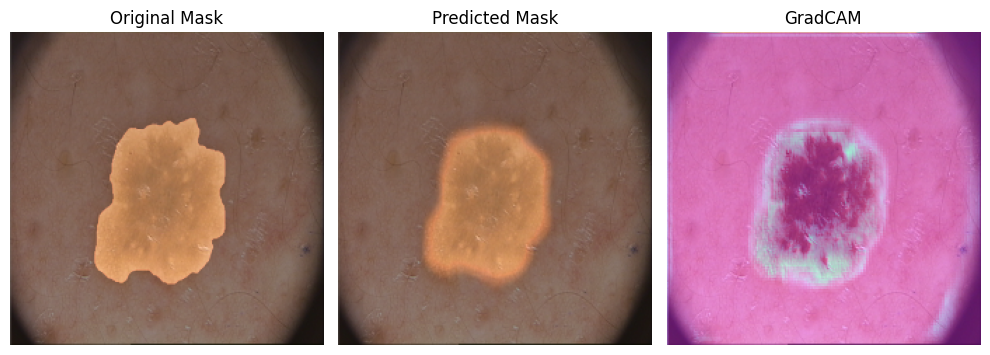


48/48 [==============================] - 12s 247ms/step - loss: 1.7567e-04 - accuracy: 0.9733 - precision: 0.9570 - recall: 0.9610 - iou: 0.9798 - val_loss: 3.1430e-04 - val_accuracy: 0.9558 - val_precision: 0.9255 - val_recall: 0.9410 - val_iou: 0.9694
Epoch 42/45
1/1 [==============================] - 0s 29ms/step


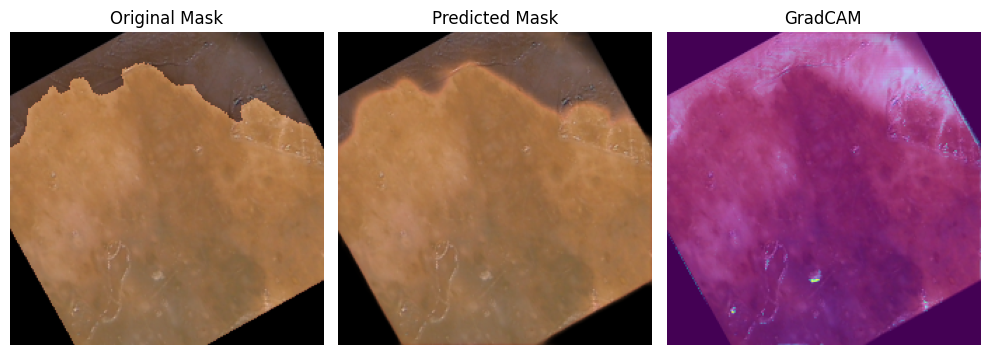


48/48 [==============================] - 12s 247ms/step - loss: 2.7363e-04 - accuracy: 0.9601 - precision: 0.9423 - recall: 0.9372 - iou: 0.9681 - val_loss: 3.5697e-04 - val_accuracy: 0.9490 - val_precision: 0.9559 - val_recall: 0.8863 - val_iou: 0.9615
Epoch 43/45
1/1 [==============================] - 0s 28ms/step


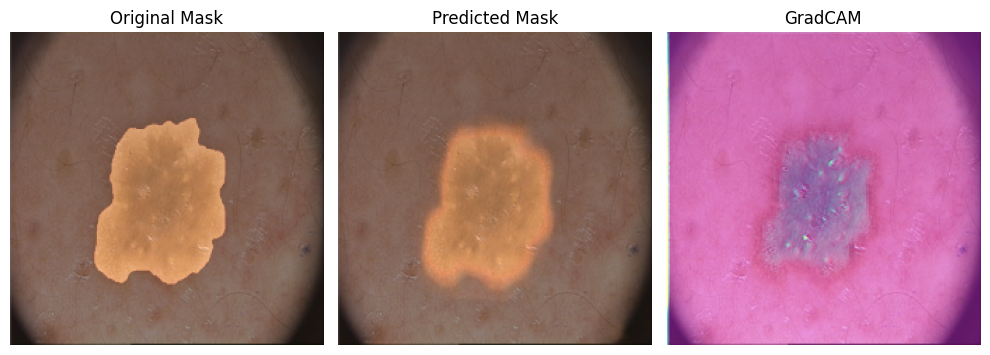


48/48 [==============================] - 12s 249ms/step - loss: 2.6074e-04 - accuracy: 0.9623 - precision: 0.9401 - recall: 0.9416 - iou: 0.9703 - val_loss: 3.5872e-04 - val_accuracy: 0.9510 - val_precision: 0.9462 - val_recall: 0.9037 - val_iou: 0.9585
Epoch 44/45
1/1 [==============================] - 0s 27ms/step


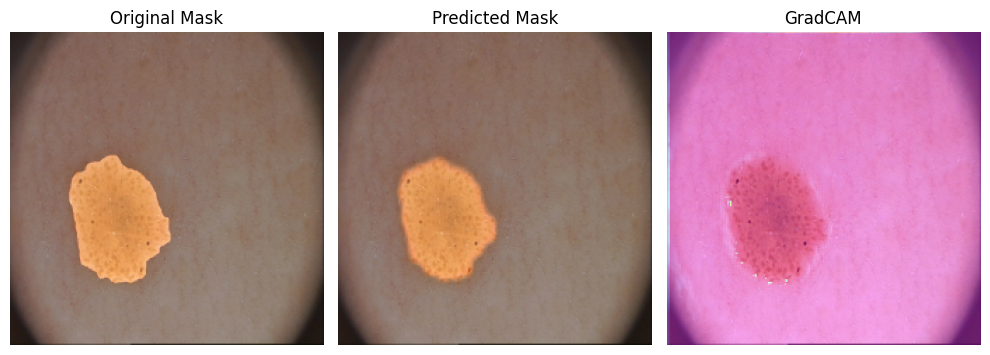


48/48 [==============================] - 12s 246ms/step - loss: 1.9153e-04 - accuracy: 0.9714 - precision: 0.9565 - recall: 0.9558 - iou: 0.9770 - val_loss: 2.8809e-04 - val_accuracy: 0.9605 - val_precision: 0.9668 - val_recall: 0.9115 - val_iou: 0.9736
Epoch 45/45
1/1 [==============================] - 0s 28ms/step


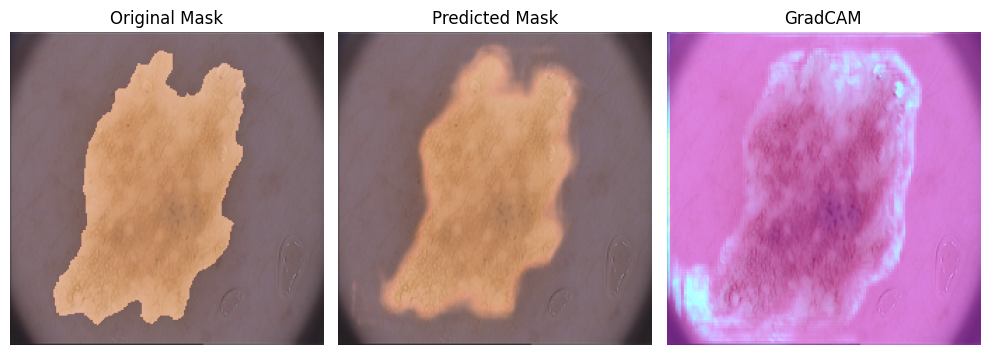


48/48 [==============================] - 14s 303ms/step - loss: 1.8041e-04 - accuracy: 0.9725 - precision: 0.9569 - recall: 0.9581 - iou: 0.9790 - val_loss: 2.5753e-04 - val_accuracy: 0.9638 - val_precision: 0.9614 - val_recall: 0.9270 - val_iou: 0.9754


In [ ]:
BATCH_SIZE = 8
SPE = len(X_train)//BATCH_SIZE


results = model.fit(
    X_train,seg_train,
    epochs=45,
    steps_per_epoch=SPE,
    batch_size=BATCH_SIZE,
    validation_data=(X_val, seg_val),
    callbacks=cb
)

In [ ]:
res = model.evaluate(X_test, Xseg_test, batch_size= 8)
print('________________________')
print('IOU:       |   {:.2f}  |'.format(res[4]*100))
print('Precision: |   {:.2f}  |'.format(res[2]*100))
print('Recall:    |   {:.2f}  |'.format(res[3]*100))
print('Accuracy:  |   {:.2f}  |'.format(res[1]*100))
print("Loss:      |   {:.2f}  |".format(res[0]*100))
print('________________________')

5/5 [==============================] - 2s 65ms/step - loss: 0.0364 - accuracy: 0.9495 - precision: 0.9579 - recall: 0.9019 - iou: 0.8261
________________________
IOU:       |   82.61  |
Precision: |   95.79  |
Recall:    |   90.19  |
Accuracy:  |   94.95  |
Loss:      |   3.64  |
________________________


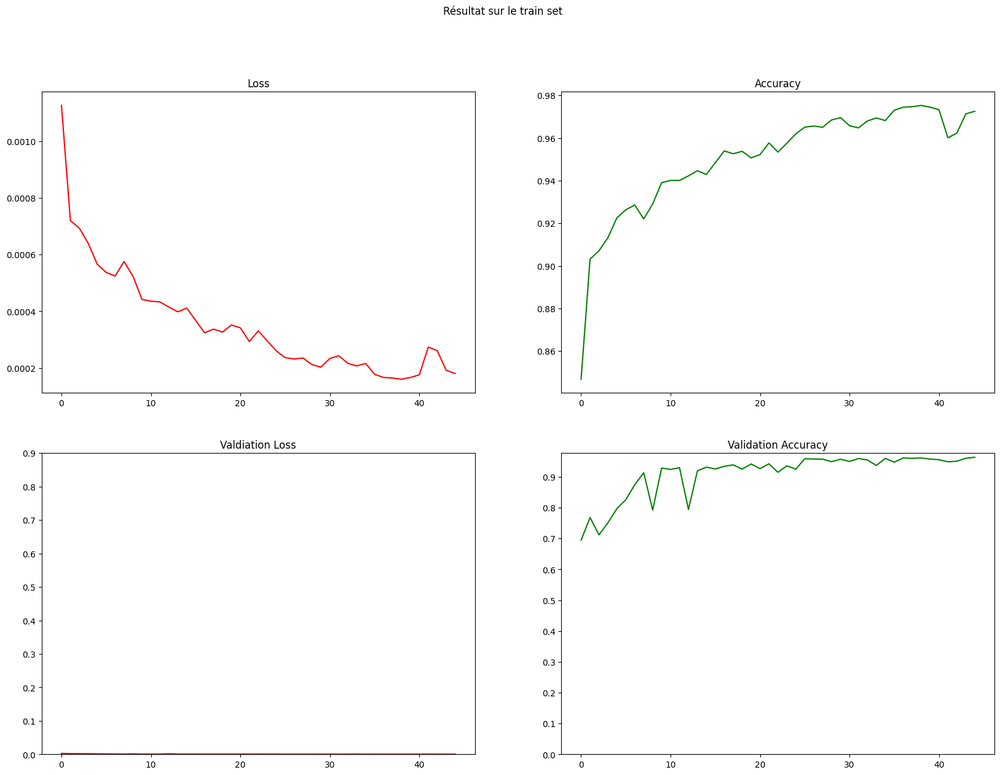

In [ ]:
plt.figure(figsize=(20, 14))
plt.suptitle('Résultat sur le train set')
plt.subplot(2,2,1)
plt.plot(results.history['loss'], 'red')
plt.title('Loss')
plt.subplot(2,2,2)
plt.plot(results.history['accuracy'], 'green')
plt.title('Accuracy')
plt.subplot(2,2,3)
plt.plot(results.history['val_loss'], 'red')
plt.yticks(list(np.arange(0.0, 1.0, 0.10)))
plt.title('Valdiation Loss')
plt.subplot(2,2,4)
plt.plot(results.history['val_accuracy'], 'green')
plt.yticks(list(np.arange(0.0, 1.0, 0.10)))
plt.title('Validation Accuracy')
plt.show()


In [ ]:
def enhance(img):
    sub = img.flatten()
    for i in range(len(sub)):
        if sub[i] > 0.5:
            sub[i] = 1
        else:
            sub[i] = 0
    return sub.reshape(224,224,1)

1/1 [==============================] - 0s 20ms/step


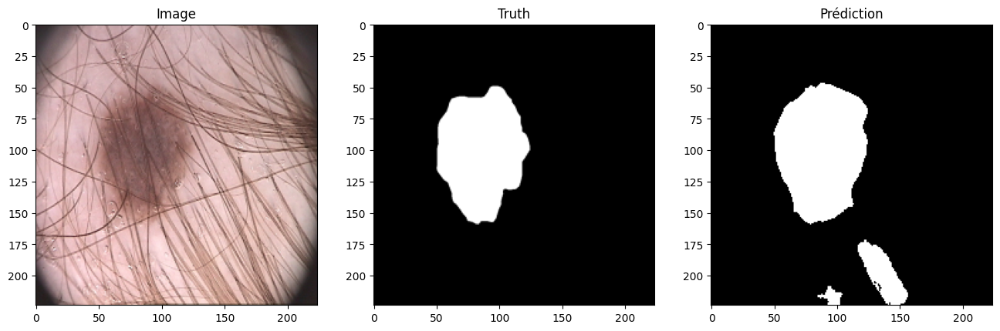

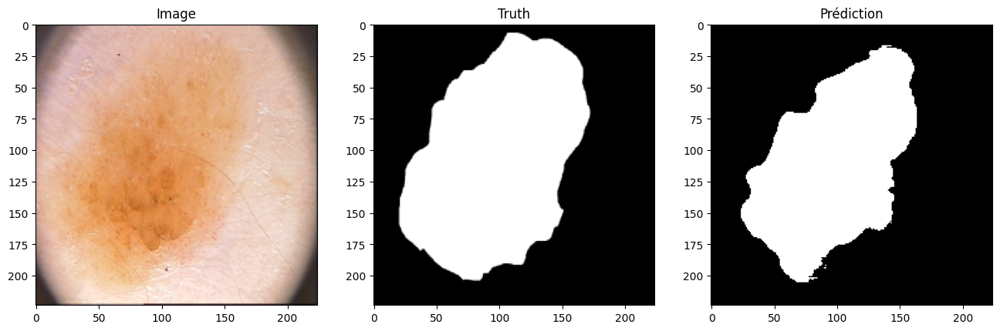

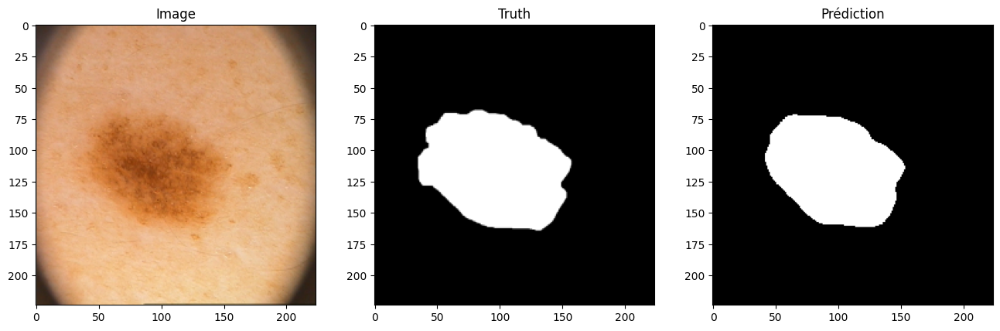

In [ ]:
for i in range(1,4):
    img_pred = model.predict(X_test[i].reshape(1,224,224,3))
    plt.figure(figsize=(16,16))
    plt.subplot(i,3,1)
    plt.imshow(X_test[i])
    plt.title('Image')
    plt.subplot(i,3,2)
    plt.imshow(Xseg_test[i], cmap='gray')
    plt.title('Truth')
    plt.subplot(i,3,3)
    plt.imshow(enhance(img_pred), cmap='gray')
    plt.title('Prédiction')

plt.show()